In [2]:
# Import necessary libraries
import numpy as np
import pandas as pd
import cv2
import os
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import classification_report, confusion_matrix
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import backend as K
import tensorflow as tf
import matplotlib.pyplot as plt


In [3]:
import os
# Define the path to your dataset
dataset_path = 'data'

# List the contents of the dataset path
print(os.listdir(dataset_path))


['Grupo_0', 'Grupo_1', '.DS_Store', 'Grupo_4', 'Grupo_3', 'Grupo_2', 'Grupo_5']


Step 3: Preprocessing the Dataset:Preprocessing steps include resizing, grayscale conversion, and normalization of the images to ensure uniformity for the CNN model.

In [33]:

# Function to load images from the dataset
def load_images_from_folder(folder_path, max_depth = 4):
    images = []
    labels = []
    corruptedFiles = []
    image_extensions = ["bmp"]

    for root, dirs, files in os.walk(folder_path):
        current_depth = root[len(folder_path):].count(os.sep)

        if current_depth <= max_depth:
            for file in files:
                if any(file.lower().endswith(ext) for ext in image_extensions):
                    img_path = os.path.join(root, file)
                    try:
                        img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
                        if img is not None:
                            img = cv2.resize(img, (64, 64))
                            images.append(img)
                            labels.append(file[6]!='0')
                    except:
                        corruptedFiles.append(img_path)

        else:
            del dirs[:]
    
    print(f"Following {len(corruptedFiles)} files are corrupt or encountered error: \n {corruptedFiles}")

    return np.array(images), np.array(labels)

images, labels = load_images_from_folder(dataset_path)
print(f"Read {len(images)} images from the data folder with shape {images.shape}")


Following 0 files are corrupt or encountered error: 
 []
Read 282 images from the data folder with shape (282, 64, 64)


[ERROR:0@13651.228] global loadsave.cpp:478 imread_ imread_('data/Grupo_4/E_4_1/Iritech/E_4_1_4/E_4_1_4_L_M_N_N_1996_0_2017.bmp'): can't read data: OpenCV(4.9.0) /Users/xperience/GHA-OpenCV-Python2/_work/opencv-python/opencv-python/opencv/modules/imgcodecs/src/bitstrm.cpp:110: error: (-2:Unspecified error) Unexpected end of input stream in function 'readBlock'



Step 4: Flatten Images for SVM (Feature Extraction)

In [34]:
# Check if images were loaded
if images.size == 0:
    print(f"Error: No images loaded from {dataset_path}. Check the path and file types.")
else:
    # Flatten images for SVM
    X_flat = images.reshape(images.shape[0], -1)

    # Scale features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X_flat)

    # Split dataset into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, labels, test_size=0.2, random_state=42)



Step 5: Implement SVM Classifier: Initially, Support Vector Machines (SVM) were used for binary classification to determine whether the subject had consumed alcohol or not, based on iris images.

In [35]:
# Create and train the SVM model
from sklearn.metrics import accuracy_score, classification_report #Import the missing functions
from sklearn.svm import SVC #Import the SVC function

svm_model = SVC(kernel='linear')
svm_model.fit(X_train, y_train) # Use X_train instead of X_train_flattened

# Evaluate the SVM model
y_pred_svm = svm_model.predict(X_test) # Use X_test instead of X_test_flattened
svm_accuracy = accuracy_score(y_test, y_pred_svm)
print(f"SVM Test Accuracy: {svm_accuracy * 100:.2f}%")
print(classification_report(y_test, y_pred_svm))

SVM Test Accuracy: 61.40%
              precision    recall  f1-score   support

       False       0.25      0.19      0.21        16
        True       0.71      0.78      0.74        41

    accuracy                           0.61        57
   macro avg       0.48      0.48      0.48        57
weighted avg       0.58      0.61      0.60        57



Step 6: Implement CNN Classifier
Train a CNN model to classify "fit" vs. "unfit" images:CNN Model: The core of the project is a CNN-based approach that captures intricate details from iris images. It consists of multiple convolutional layers, pooling layers, and fully connected layers to classify whether an individual has consumed alcohol or not.
The CNN was trained on augmented datasets for better performance and generalization.

In [36]:
print(images.shape)


(282, 64, 64)


CNN Architecture:

Input: Grayscale images of size 64x64.
Layers: Multiple Conv2D layers (32 and 64 filters), MaxPooling, Flatten, Dense layers for classification.
Dropout: Applied to prevent overfitting.
Output: A softmax layer for binary classification (Alcohol or No-Alcohol).

In [38]:

from tensorflow.keras.utils import to_categorical # Import the to_categorical function from Keras
from tensorflow.keras.layers import Dropout, Conv2D, MaxPooling2D, Flatten, Dense # Import the Dropout class from Keras
from tensorflow.keras.models import Sequential

y_train_cnn = to_categorical(y_train, num_classes=2)
y_test_cnn = to_categorical(y_test, num_classes=2)

# Create and train the CNN model
cnn_model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(64, 64, 1)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(2, activation='softmax')
])

cnn_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Reshape X_train and X_test to match the CNN input shape (64, 64, 1)
X_train_cnn = X_train.reshape(-1, 64, 64, 1) # Reshape to the correct image dimensions
X_test_cnn = X_test.reshape(-1, 64, 64, 1) # Reshape to the correct image dimensions

# Train the CNN model using the reshaped data
cnn_model.fit(X_train_cnn, y_train_cnn, epochs=10, batch_size=32, validation_data=(X_test_cnn, y_test_cnn))

# Evaluate the CNN model
cnn_loss, cnn_accuracy = cnn_model.evaluate(X_test_cnn, y_test_cnn)
print(f"CNN Test Accuracy: {cnn_accuracy * 100:.2f}%")

Epoch 1/10


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 51ms/step - accuracy: 0.5972 - loss: 1.2930 - val_accuracy: 0.7193 - val_loss: 0.6443
Epoch 2/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - accuracy: 0.7682 - loss: 0.5768 - val_accuracy: 0.7193 - val_loss: 0.6441
Epoch 3/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - accuracy: 0.8442 - loss: 0.4781 - val_accuracy: 0.7193 - val_loss: 0.6873
Epoch 4/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - accuracy: 0.8186 - loss: 0.4652 - val_accuracy: 0.7193 - val_loss: 0.6178
Epoch 5/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - accuracy: 0.8281 - loss: 0.4679 - val_accuracy: 0.7193 - val_loss: 0.6730
Epoch 6/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - accuracy: 0.8488 - loss: 0.4257 - val_accuracy: 0.7193 - val_loss: 0.6184
Epoch 7/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - accuracy: 0.8200 - loss: 0.4945 - val_accuracy: 0.7193 - val_loss: 0.6127
Epoch 8/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 0.8270 - loss: 0.5231 - val_accuracy: 0.7193 - val_loss: 0.6792
Epoch 9/10


Step 8: Fine-Tuning and Data Augmentation:Data augmentation (basic, medium, and aggressive) is applied to increase the diversity of the dataset and improve model robustness.

In [39]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Create an ImageDataGenerator for data augmentation
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Fit the ImageDataGenerator to the training data
datagen.fit(X_train_cnn)

# Train the CNN model using augmented data
cnn_model.fit(datagen.flow(X_train_cnn, y_train_cnn, batch_size=32),
              epochs=10,
              validation_data=(X_test_cnn, y_test_cnn))


Epoch 1/10
3/8 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - accuracy: 0.8733 - loss: 0.4673 

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


8/8 ━━━━━━━━━━━━━━━━━━━━ 1s 41ms/step - accuracy: 0.8380 - loss: 0.4913 - val_accuracy: 0.7193 - val_loss: 0.8075
Epoch 2/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - accuracy: 0.8123 - loss: 0.5396 - val_accuracy: 0.7193 - val_loss: 0.5929
Epoch 3/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step - accuracy: 0.7865 - loss: 0.5853 - val_accuracy: 0.7193 - val_loss: 0.6054
Epoch 4/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step - accuracy: 0.7243 - loss: 0.6027 - val_accuracy: 0.7193 - val_loss: 0.6155
Epoch 5/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - accuracy: 0.8050 - loss: 0.5151 - val_accuracy: 0.7193 - val_loss: 0.6608
Epoch 6/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 0.8102 - loss: 0.4716 - val_accuracy: 0.7193 - val_loss: 0.6707
Epoch 7/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - accuracy: 0.8180 - loss: 0.4801 - val_accuracy: 0.7193 - val_loss: 0.6064
Epoch 8/10
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - accuracy: 0.7262 - loss: 0.5911 - val_accuracy: 0.7193 - val_loss: 0.5921
Epoch 9/10


Step 9: Semantic Segmentation (U-Net Model)
Implementing semantic segmentation will allow you to detect specific regions in the image that indicate alcohol influence. One common architecture for this task is the U-Net model.
We used U-Net architecture for semantic segmentation, which is a well-established model for medical image segmentation. U-Net performs pixel-wise classification to identify which part of the image belongs to the iris.
The U-Net network has an encoder-decoder structure, where the encoder extracts important features, and the decoder reconstructs the segmented image.

Step 9.1: Define and Train U-Net Model

In [ ]:
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
from tensorflow.keras.models import Model

def unet_model(input_size=(64, 64, 1)):
    inputs = Input(input_size)

    # Encoding path
    c1 = Conv2D(32, (3, 3), activation='relu', padding='same')(inputs)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = Conv2D(64, (3, 3), activation='relu', padding='same')(p1)
    p2 = MaxPooling2D((2, 2))(c2)

    # Bottleneck
    c3 = Conv2D(128, (3, 3), activation='relu', padding='same')(p2)

    # Decoding path
    u1 = UpSampling2D((2, 2))(c3)
    c4 = Conv2D(64, (3, 3), activation='relu', padding='same')(u1)
    merge1 = concatenate([c4, c2])

    u2 = UpSampling2D((2, 2))(merge1)
    c5 = Conv2D(32, (3, 3), activation='relu', padding='same')(u2)
    merge2 = concatenate([c5, c1])

    outputs = Conv2D(1, (1, 1), activation='sigmoid')(merge2)

    model = Model(inputs=inputs, outputs=outputs)
    return model

# Initialize the U-Net model
unet = unet_model()
unet.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Placeholder for segmentation labels
# Here, 'y_train_segmentation' should be the segmentation masks of your images.
# These masks should be binary (0 and 1) and of the same size as the input images.
# Replace this with actual segmentation masks in your project.
y_train_segmentation = np.random.rand(X_train_cnn.shape[0], 64, 64, 1)  # Example data

# Train the U-Net model
unet.fit(X_train_cnn, y_train_segmentation, epochs=10, batch_size=32, validation_split=0.2)


Epoch 1/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 11s 125ms/step - accuracy: 0.0000e+00 - loss: 0.6939 - val_accuracy: 0.0000e+00 - val_loss: 0.6932
Epoch 2/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.0000e+00 - loss: 0.6932 - val_accuracy: 0.0000e+00 - val_loss: 0.6932
Epoch 3/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.0000e+00 - loss: 0.6932 - val_accuracy: 0.0000e+00 - val_loss: 0.6932
Epoch 4/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.0000e+00 - loss: 0.6932 - val_accuracy: 0.0000e+00 - val_loss: 0.6932
Epoch 5/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.0000e+00 - loss: 0.6932 - val_accuracy: 0.0000e+00 - val_loss: 0.6932
Epoch 6/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.0000e+00 - loss: 0.6932 - val_accuracy: 0.0000e+00 - val_loss: 0.6932
Epoch 7/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.0000e+00 - loss: 0.6932 - val_accuracy: 0.0000e+00 - val_loss: 0.6932
Epoch 8/10
41/41 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - 

Step 10: Model Integration and Testing
After training both the CNN classifier and the U-Net segmentation model, integrate them to form a complete pipeline.

In [ ]:
def predict_and_segment(image):
    # Resize and normalize the image
    image_resized = cv2.resize(image, (64, 64)) / 255.0
    image_resized = image_resized.reshape(1, 64, 64, 1)

    # Predict segmentation mask
    segmentation_mask = unet.predict(image_resized)

    # Apply segmentation mask to the image
    segmented_image = image_resized * segmentation_mask

    # Use the CNN model to predict classification on segmented image
    prediction = cnn_model.predict(segmented_image)
    predicted_class = np.argmax(prediction, axis=1)[0]

    return predicted_class, segmentation_mask

# Test the integrated model on a new image
# new_image = cv2.imread('path_to_image', cv2.IMREAD_GRAYSCALE)
# predicted_class, segmentation_mask = predict_and_segment(new_image)
# print(f"Predicted Class: {'Fit' if predicted_class == 0 else 'Unfit'}")


Step 11: Save Models for Future Use
Save both the CNN classifier and U-Net segmentation models for future use or deployment.

In [ ]:
# Save CNN model
cnn_model.save('cnn_model.keras')

# Save U-Net model
unet.save('unet_model.keras')

Step 1: Setting Up Real-Time Testing Environment

In [ ]:
!pip install opencv-python-headless tensorflow


Step 2: Load Pre-trained Models
Load your pre-trained CNN and U-Net models.

In [ ]:
# Load pre-trained models (if saved with .keras extension)
cnn_model = load_model('cnn_model.keras')
unet = load_model('unet_model.keras')

/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 10 variables whereas the saved optimizer has 18 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))
/usr/local/lib/python3.10/dist-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 14 variables whereas the saved optimizer has 26 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [ ]:
from tensorflow.keras.models import load_model

# Load the model from the file
model_path = '/content/cnn_model.keras'
cnn_model = load_model(model_path)


Real-Time Testing Simulation
A. Using Images

If you want to test using a single image:

In [ ]:
from tensorflow.keras.preprocessing import image
import numpy as np
import cv2

def preprocess_image(img_path):
    # Check if the image was loaded correctly
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Could not load image at {img_path}")
        return None  # Return None if image loading fails

    img = cv2.resize(img, (64, 64))
    img = img.reshape(-1, 64, 64, 1)  # Reshape for CNN
    img = img / 255.0  # Normalize
    return img

# Load and preprocess the image
img_path = '/content/drive/MyDrive/MajorProject/input images/E_2_1_1_L_M_N_N_1980_9_2017.bmp'
processed_img = preprocess_image(img_path)

if processed_img is not None:
    # Make prediction
    prediction = cnn_model.predict(processed_img)

    # Interpret the prediction
    if np.argmax(prediction) == 0:
        result = "fit"
    else:
        result = "unfit"

    print(f'Prediction: {result}')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Prediction: unfit


B. Using a Video File

If you have a video file, you can process it frame by frame:

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step


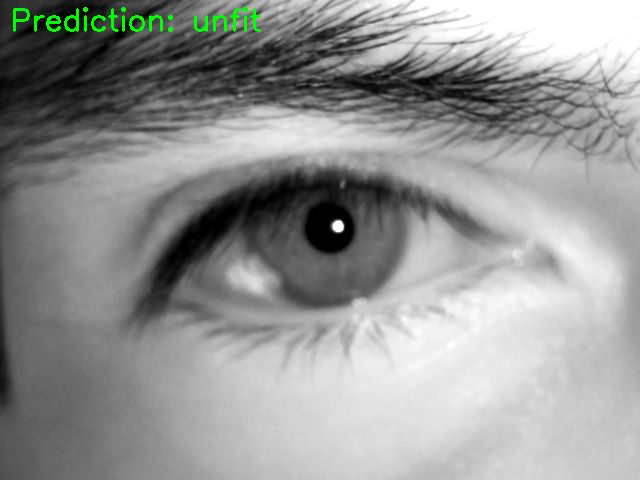

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


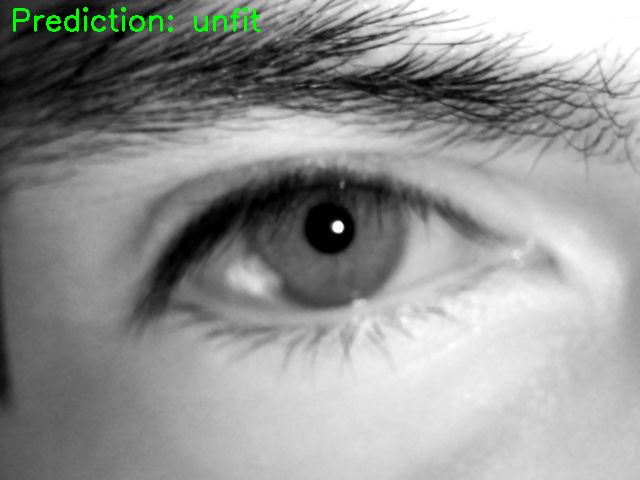

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


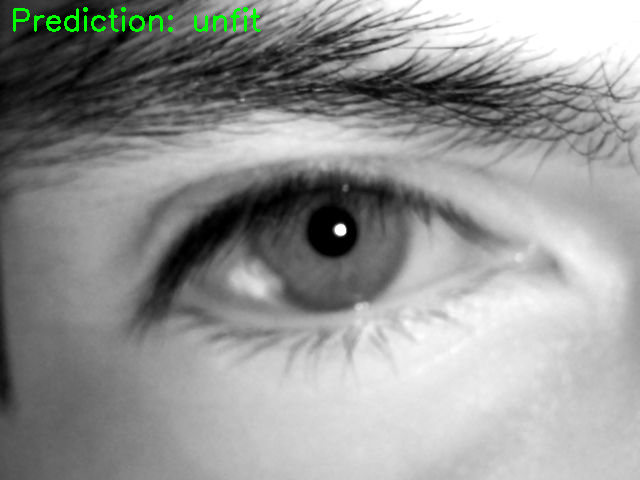

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


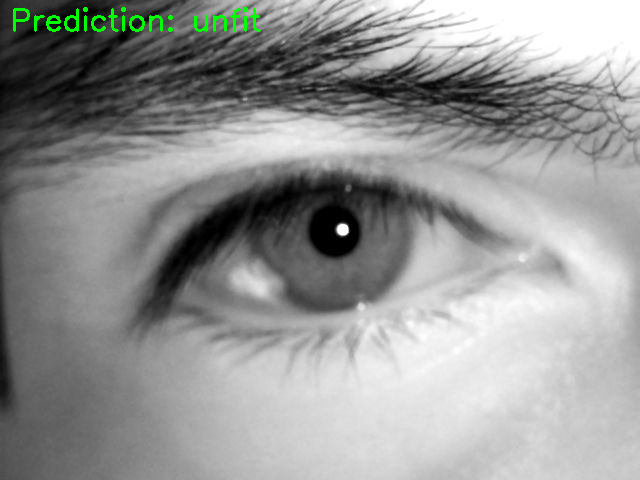

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


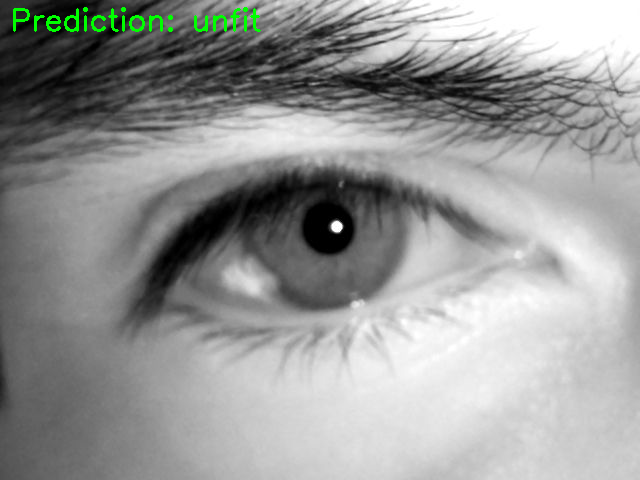

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


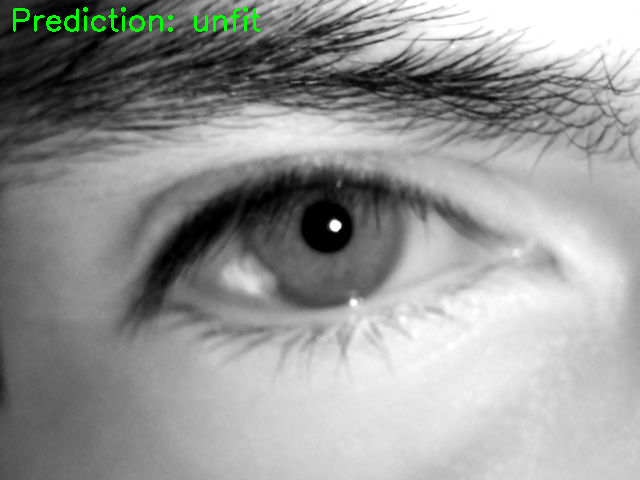

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


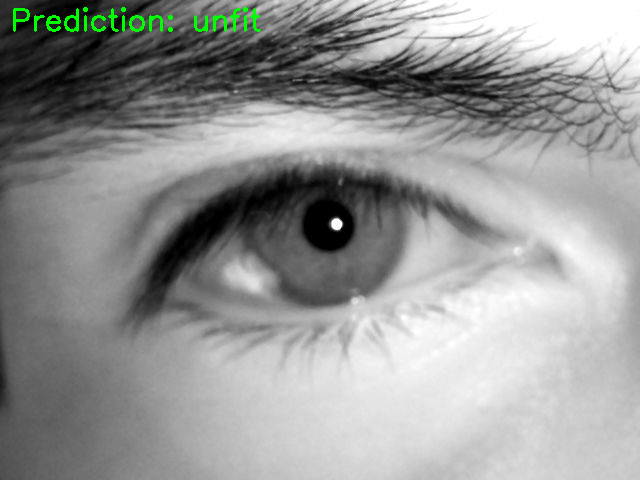

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


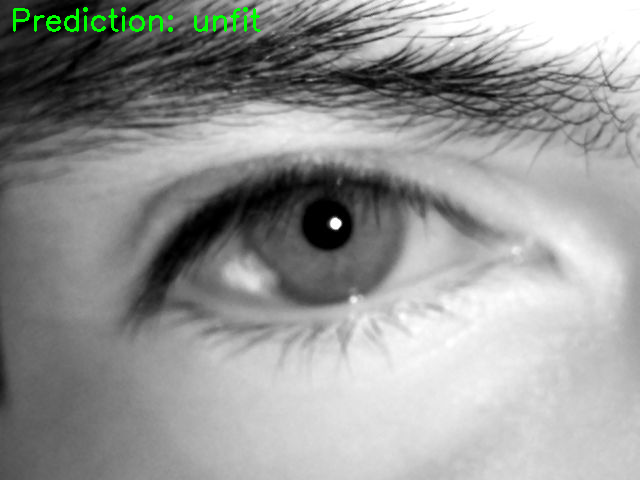

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


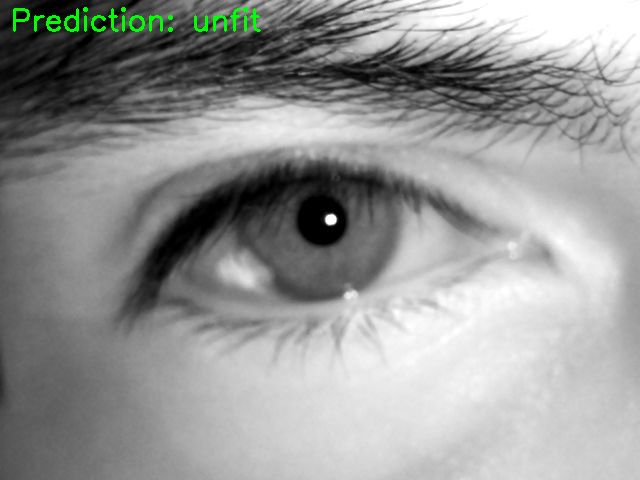

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


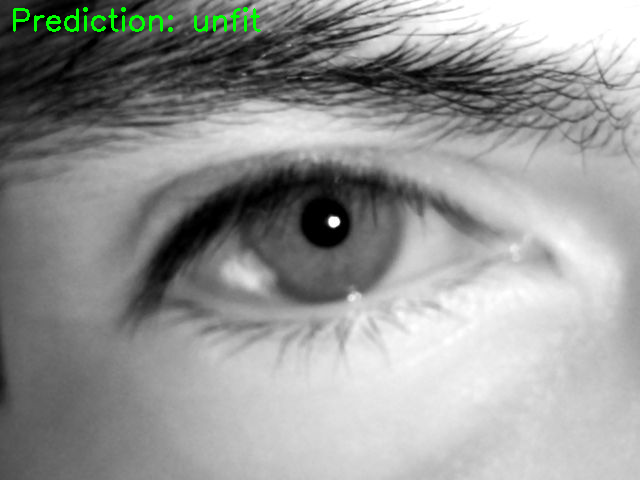

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


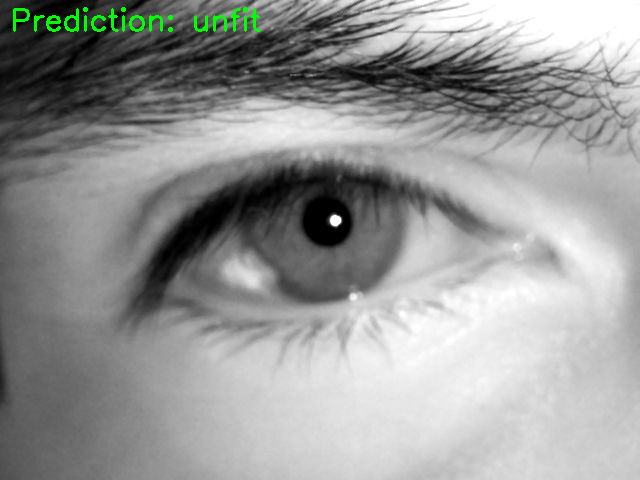

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


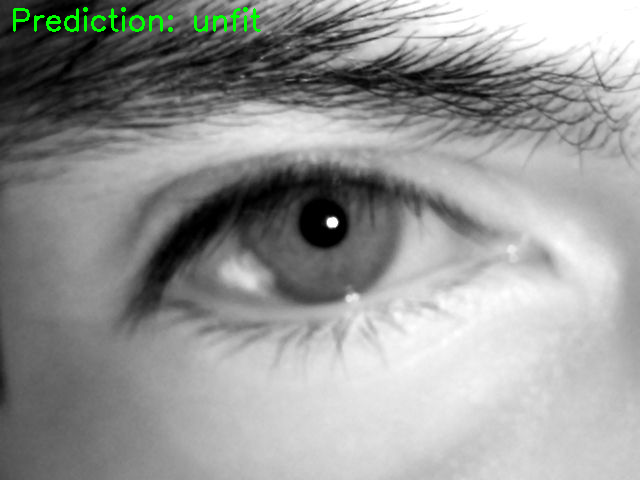

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


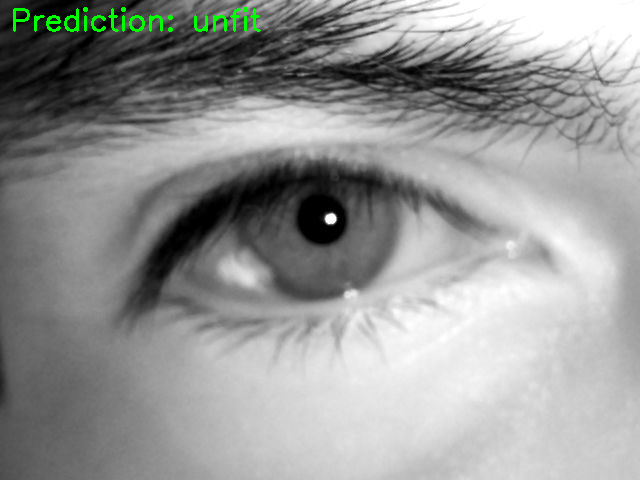

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


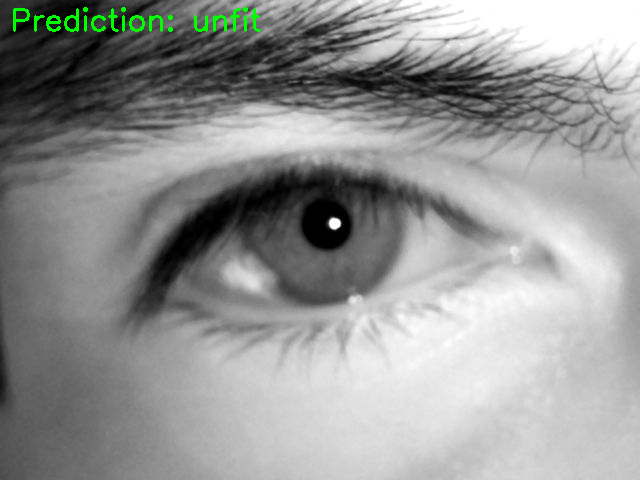

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


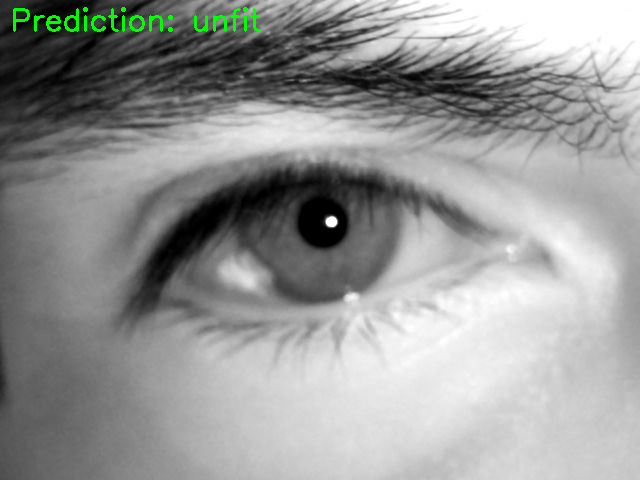

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


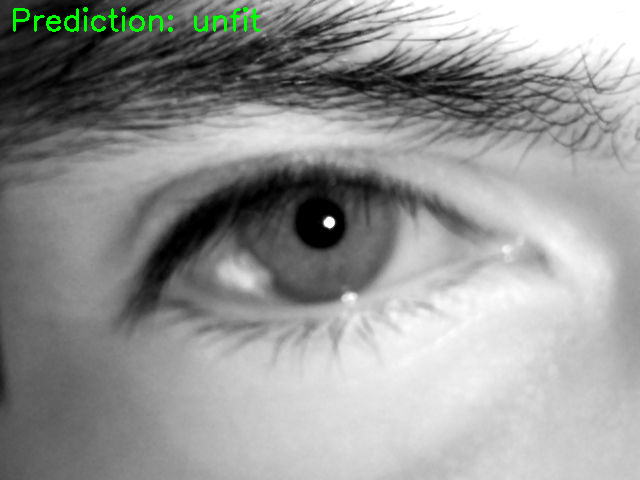

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


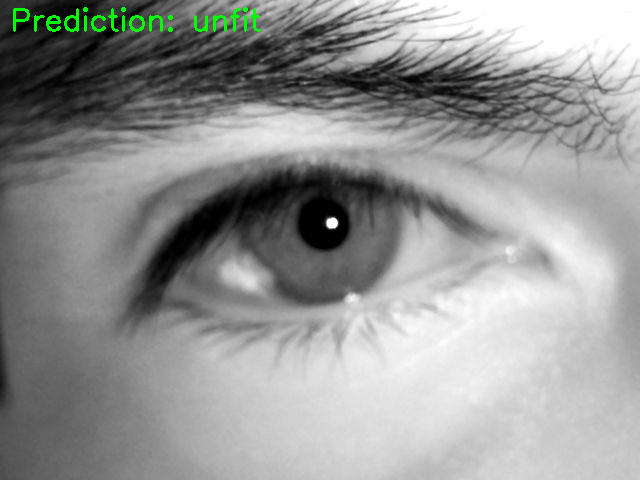

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


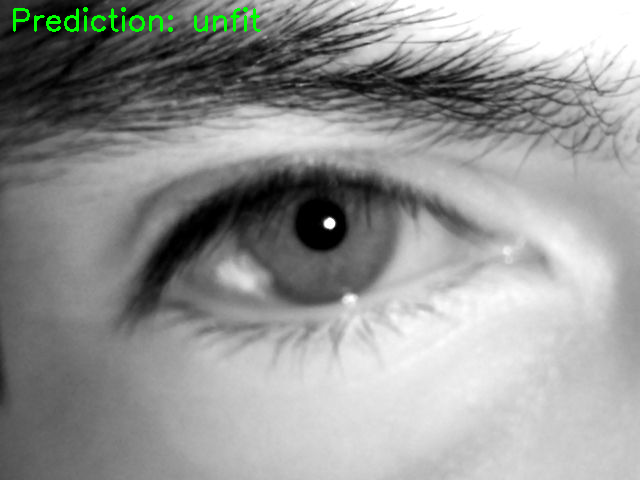

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


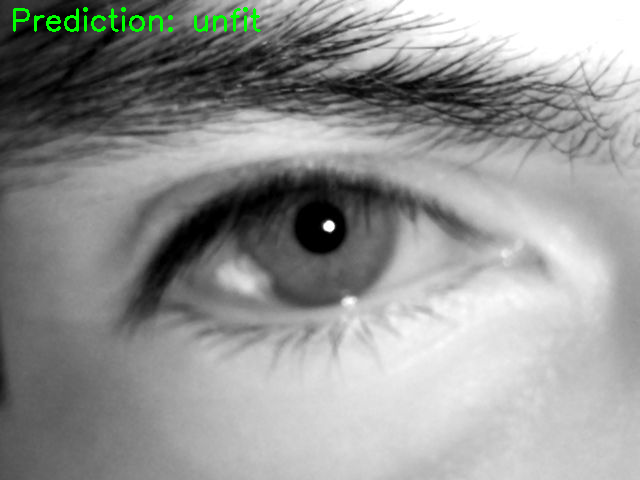

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


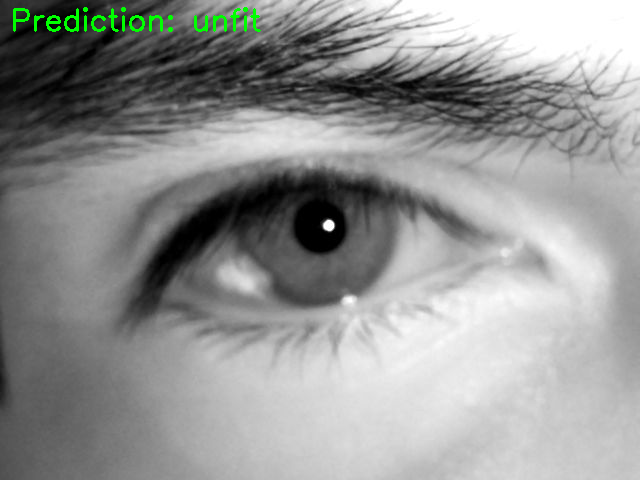

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


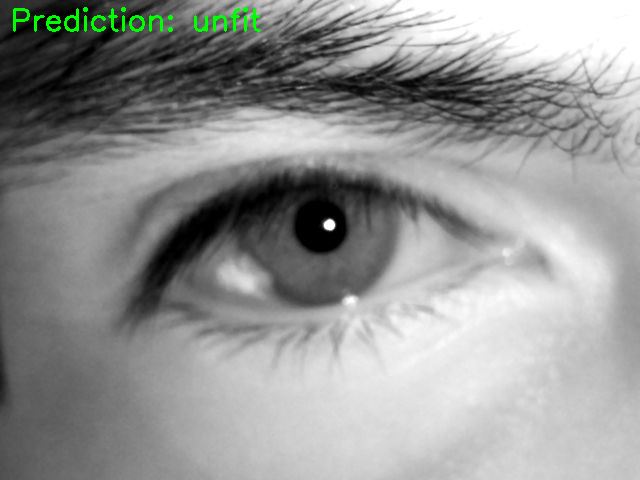

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


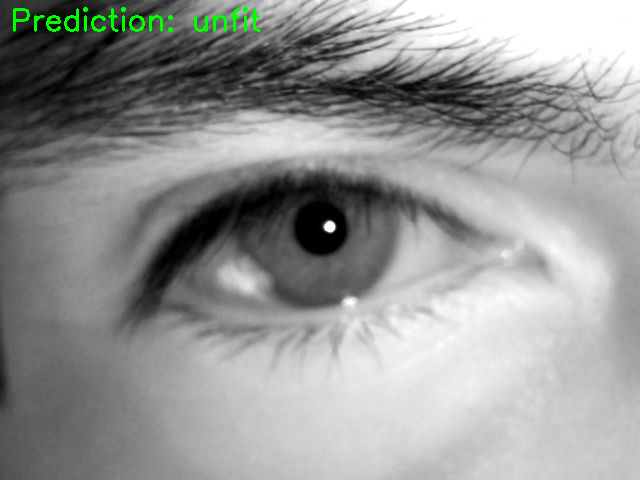

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


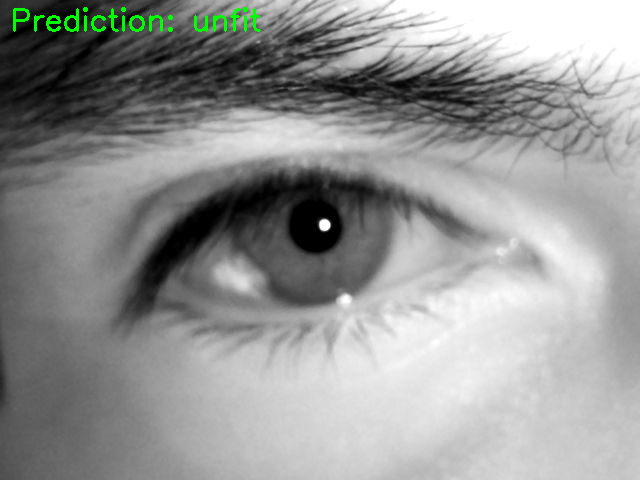

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


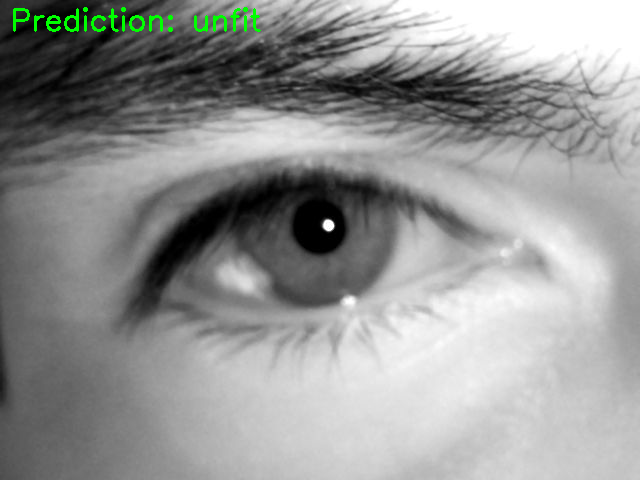

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


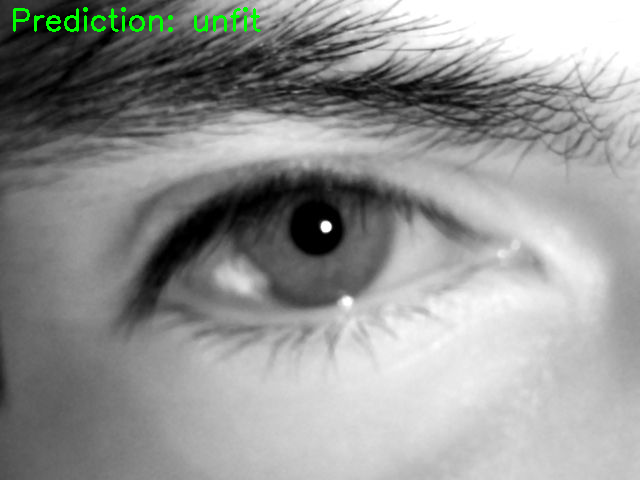

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


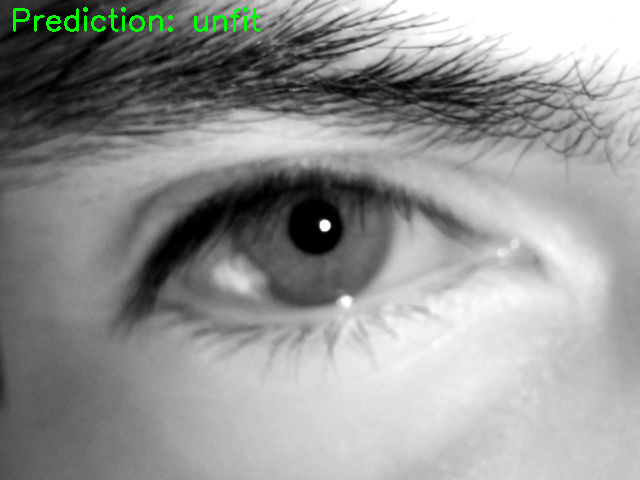

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


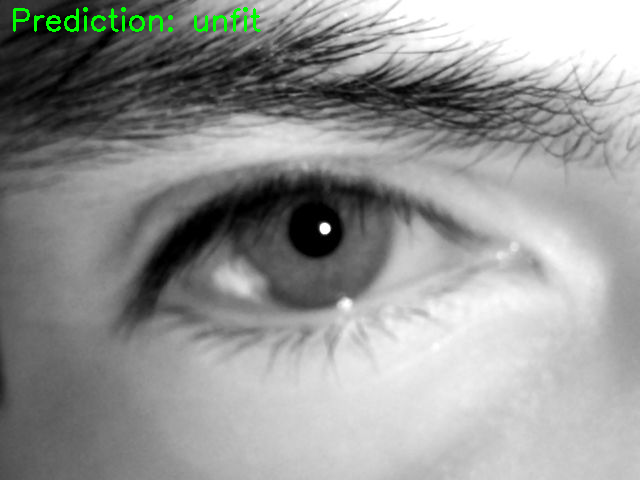

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


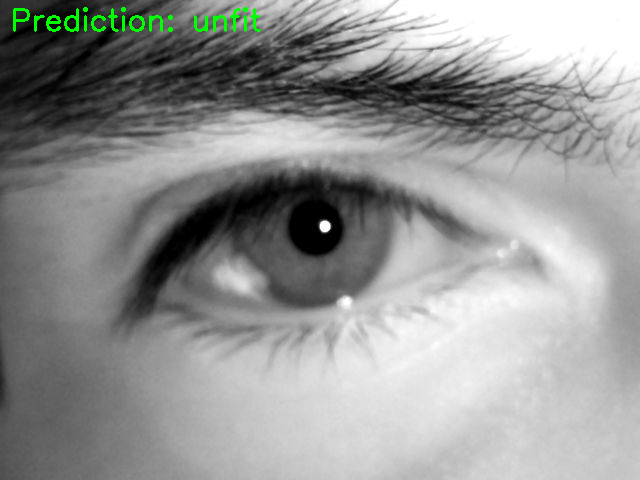

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


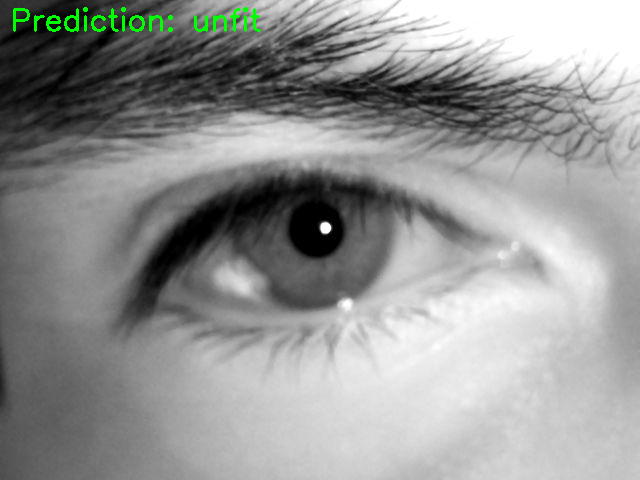

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


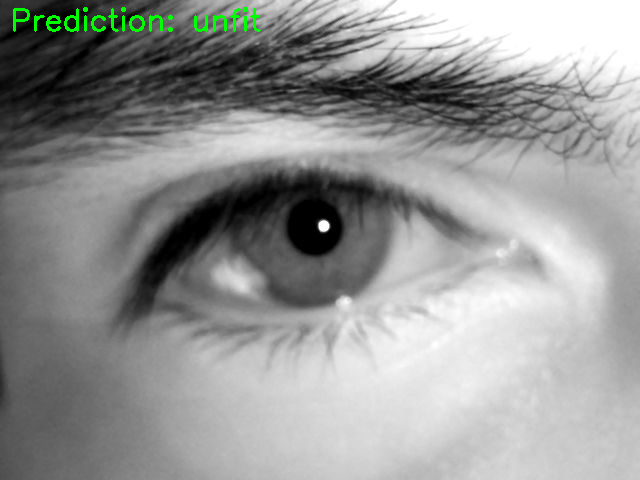

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


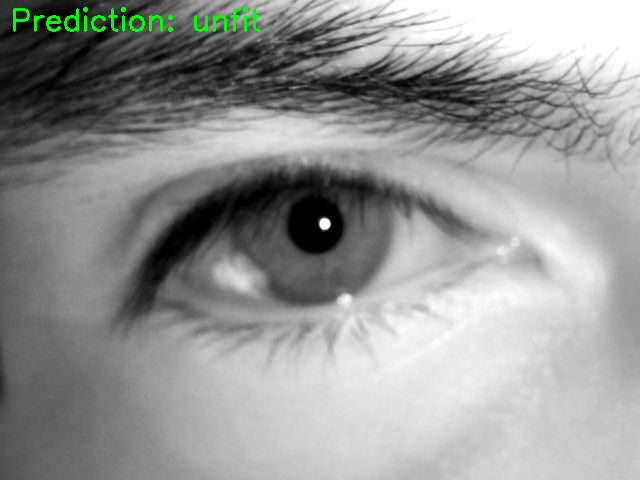

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


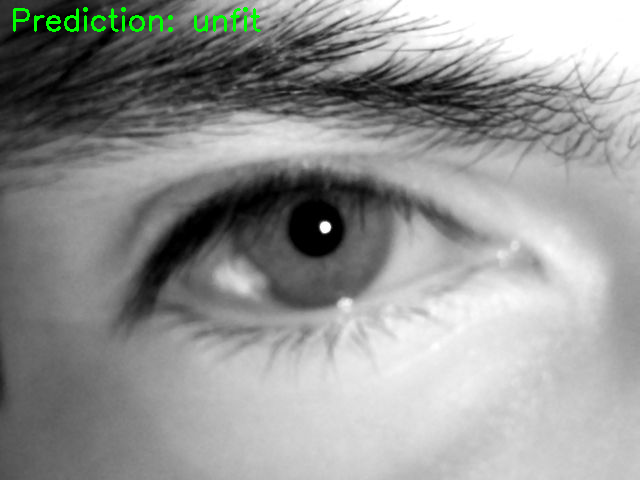

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


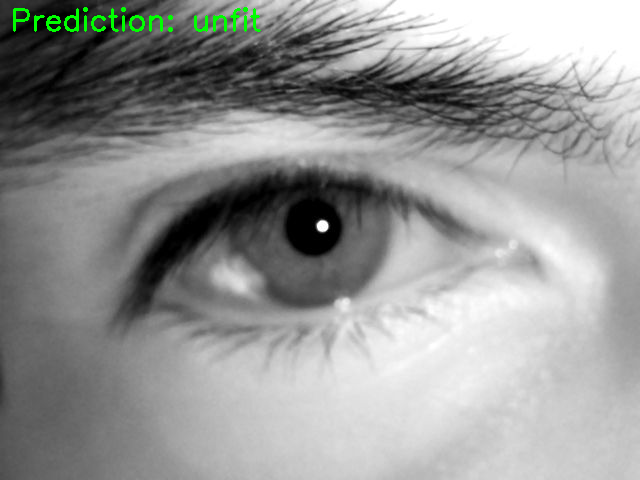

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


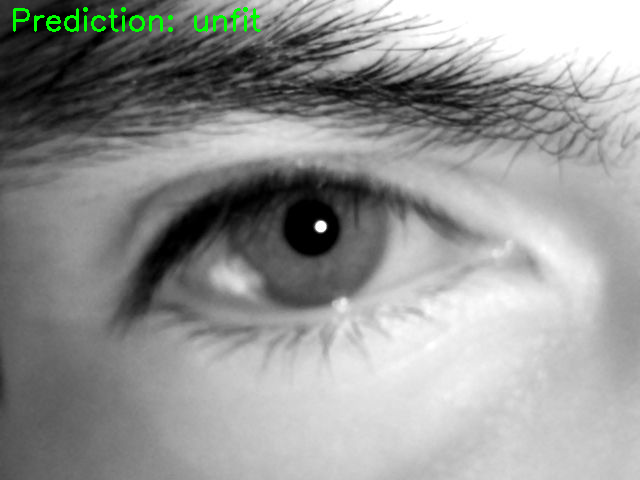

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


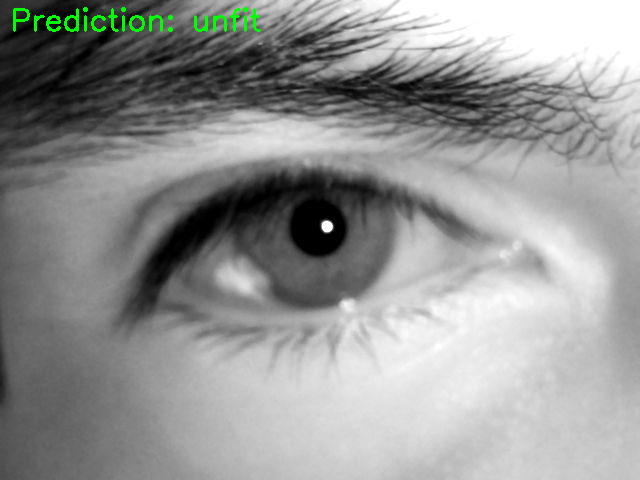

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


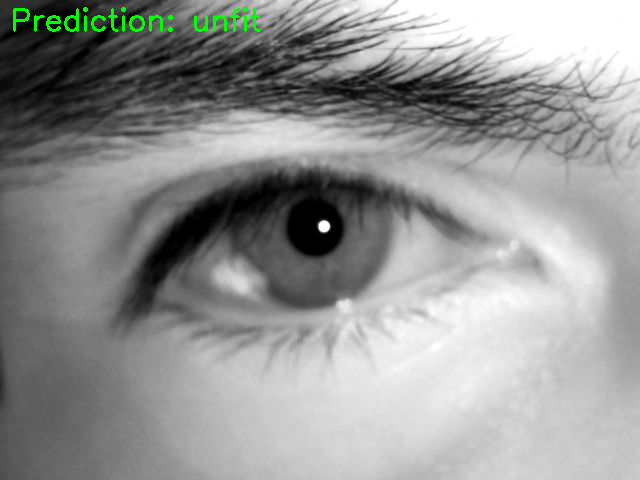

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


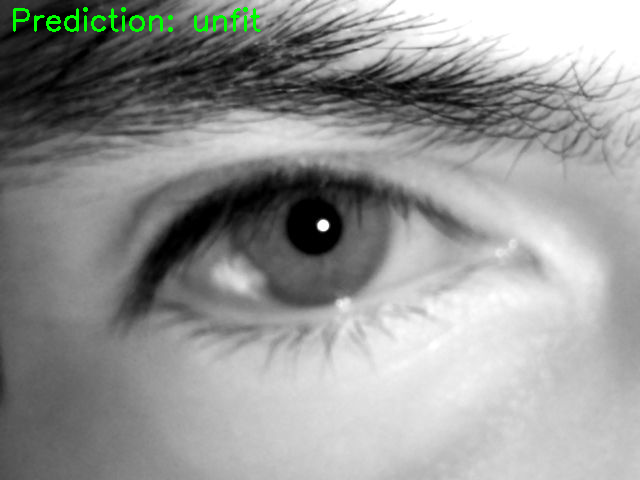

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


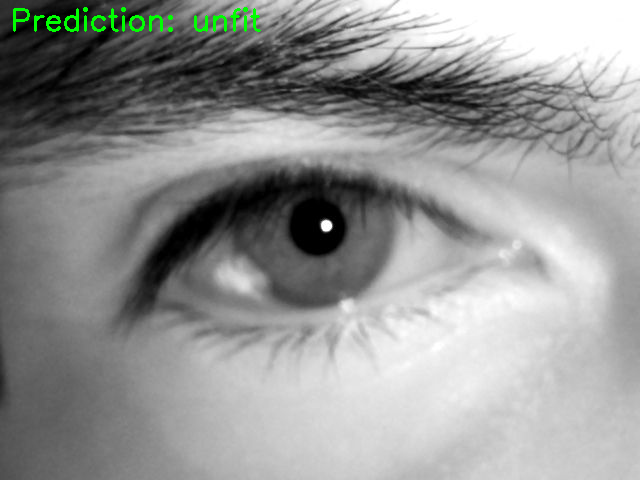

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


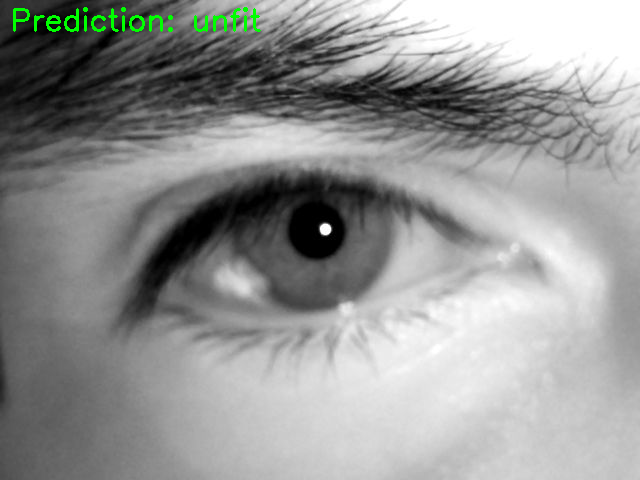

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


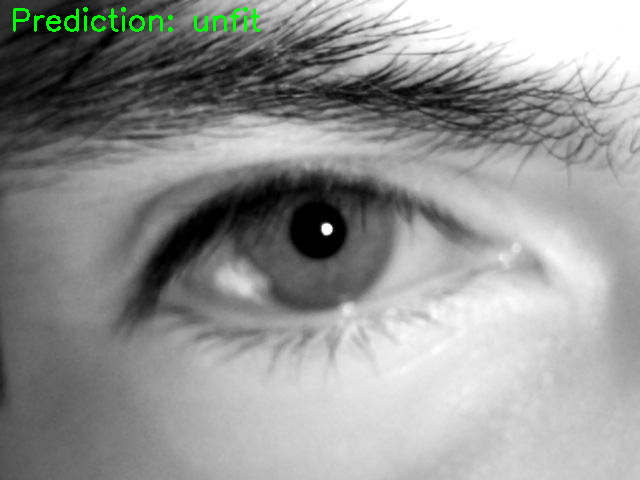

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


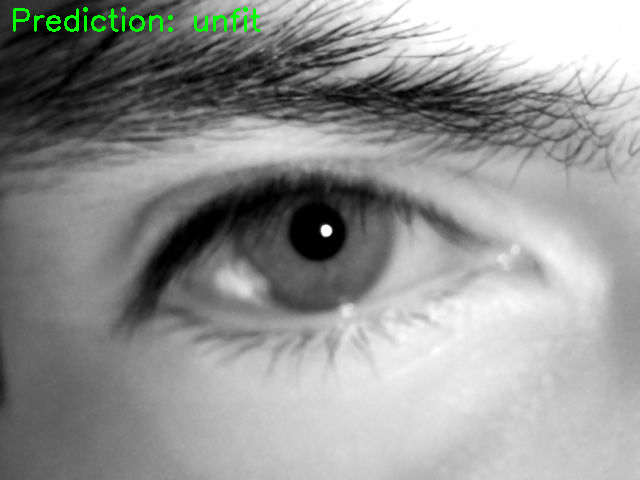

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


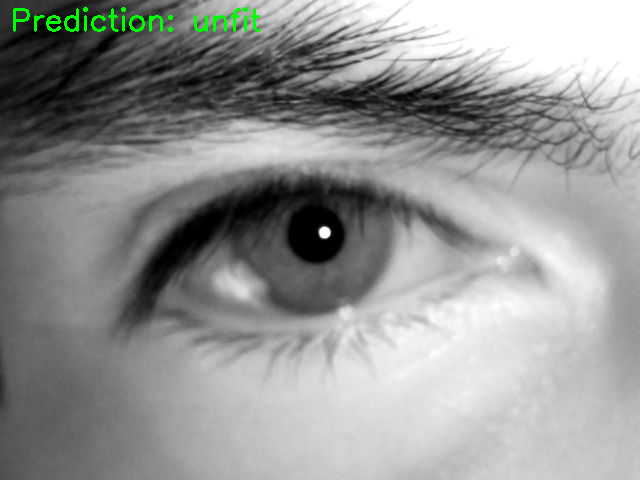

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


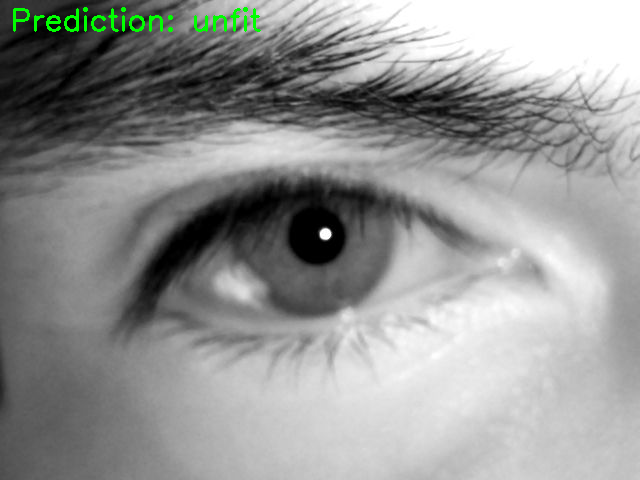

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


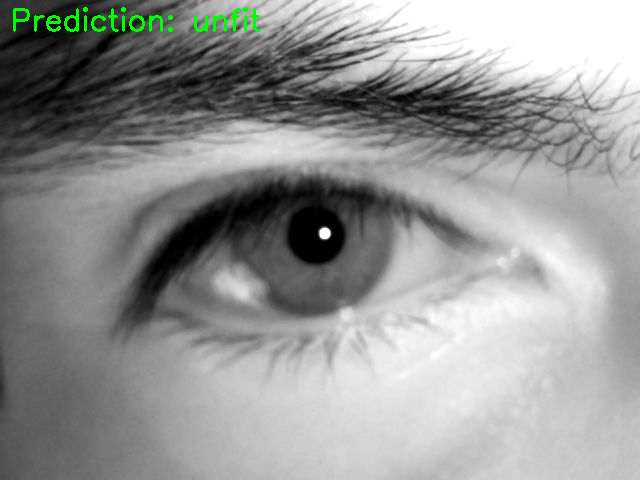

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


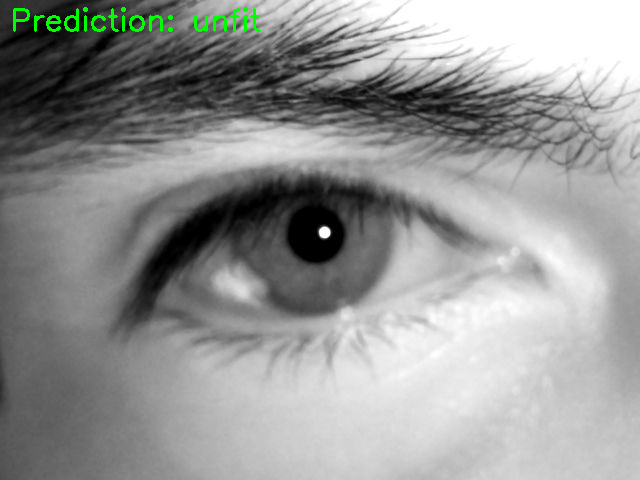

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


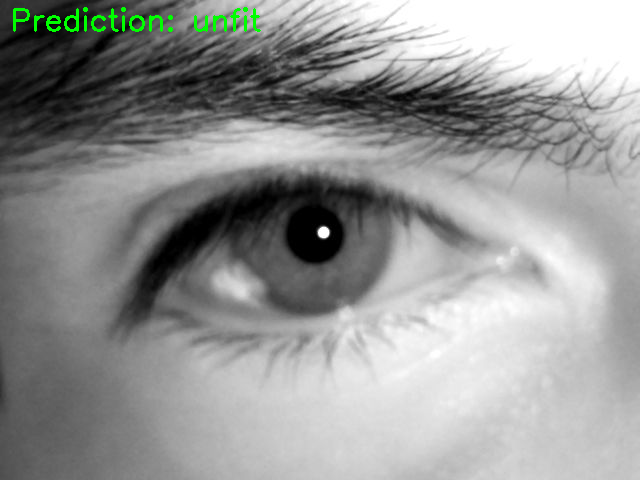

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


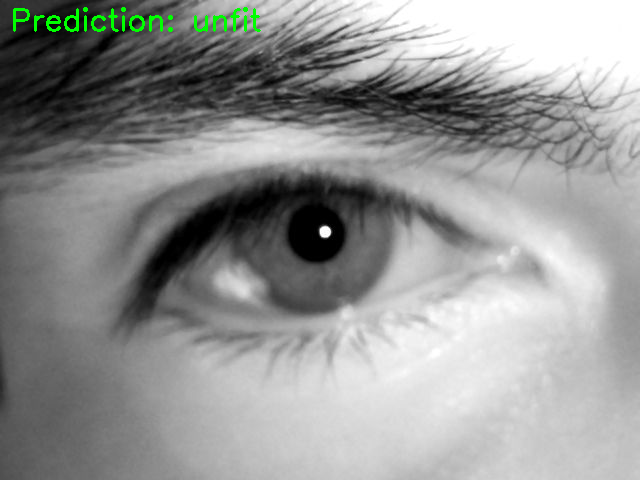

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


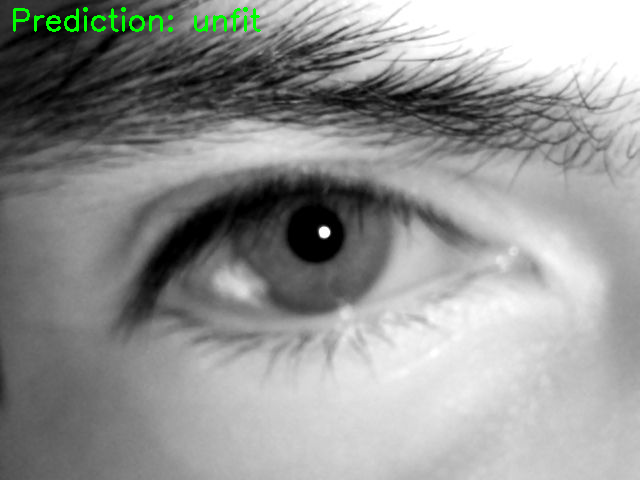

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


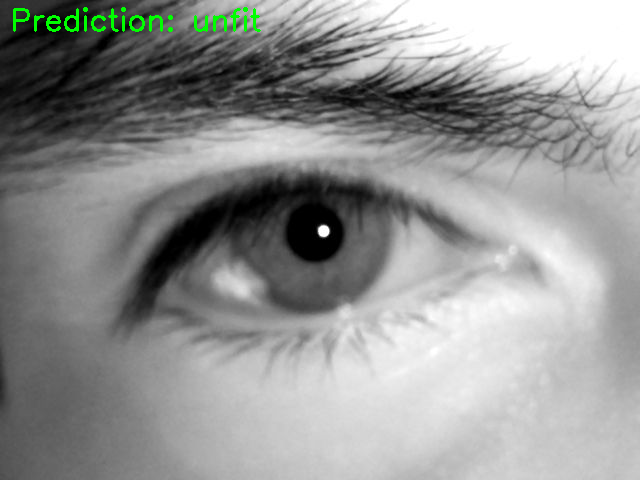

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


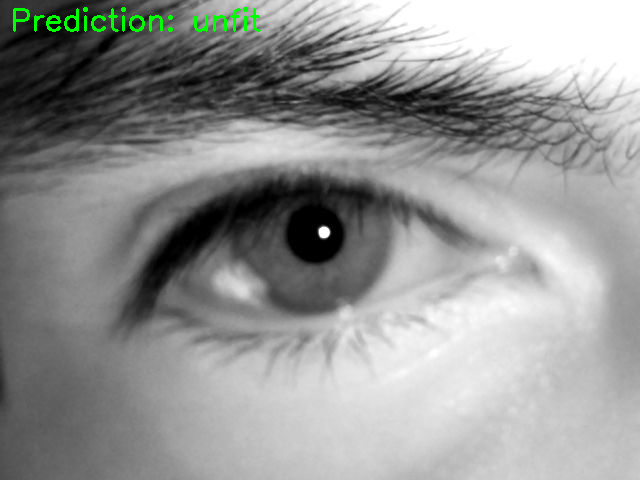

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


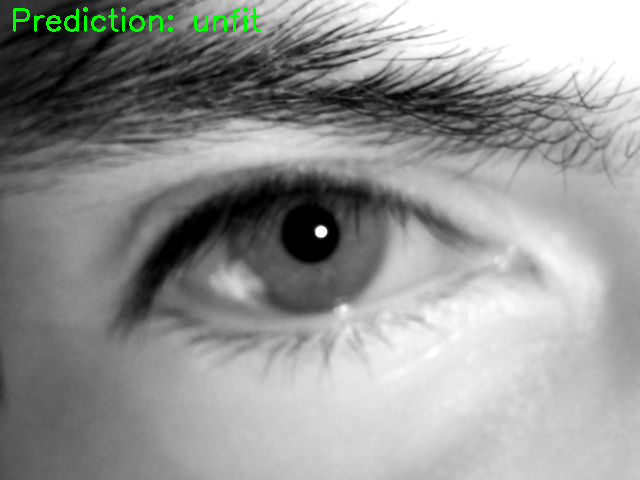

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


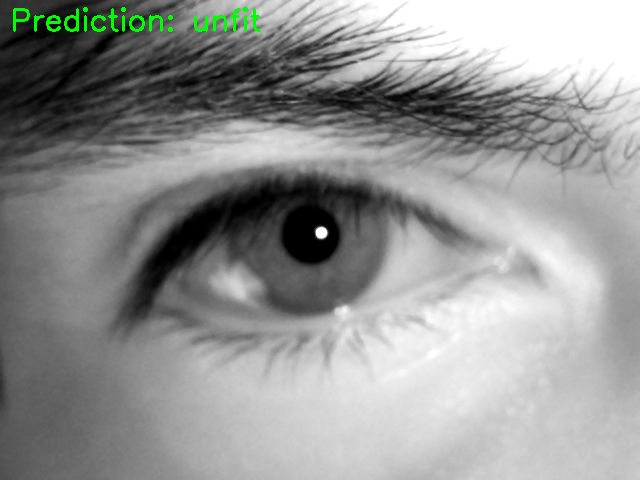

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


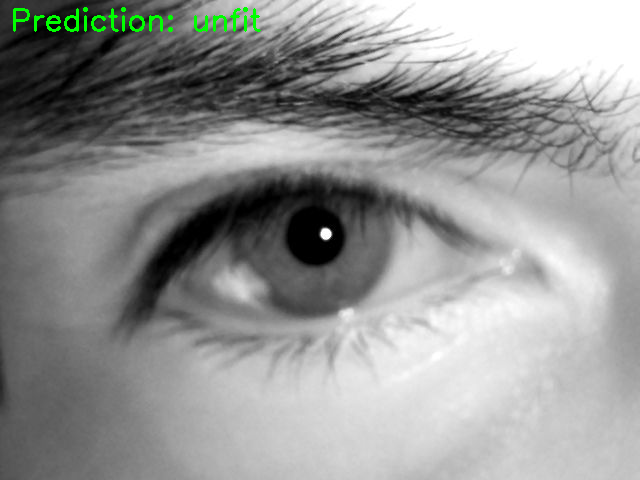

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


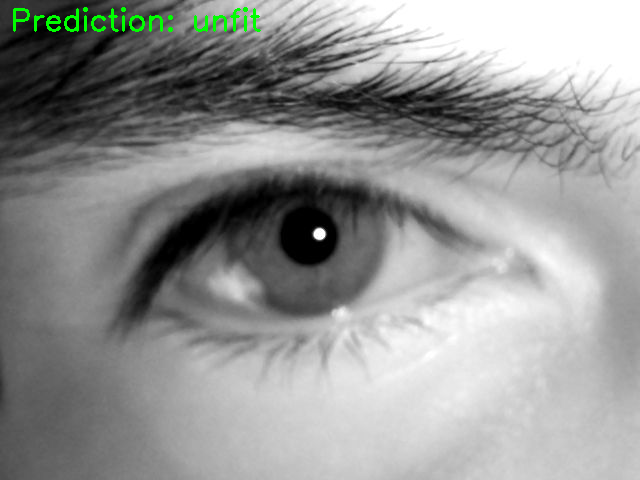

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


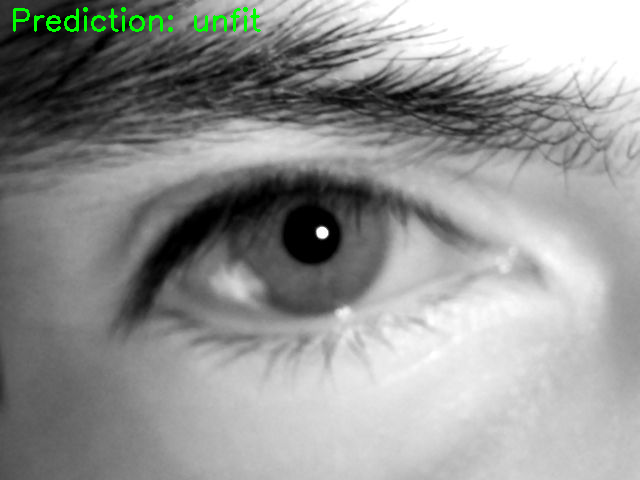

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


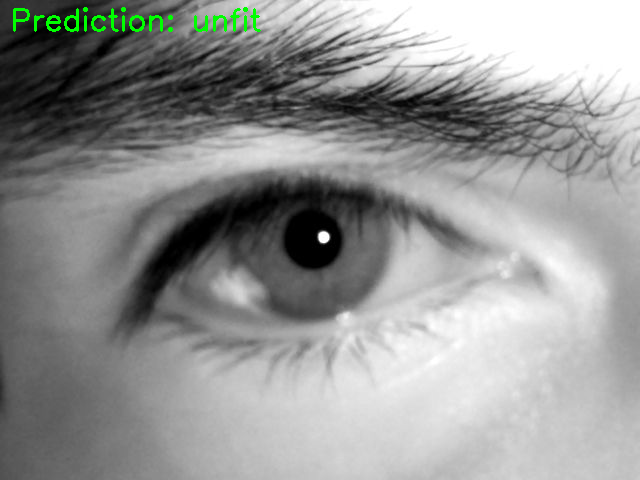

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


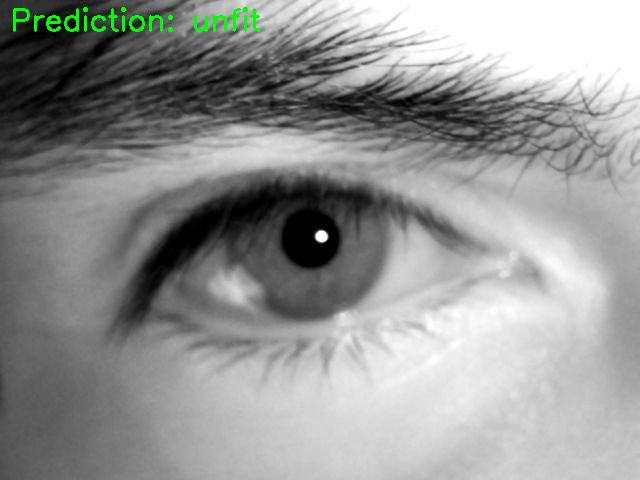

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


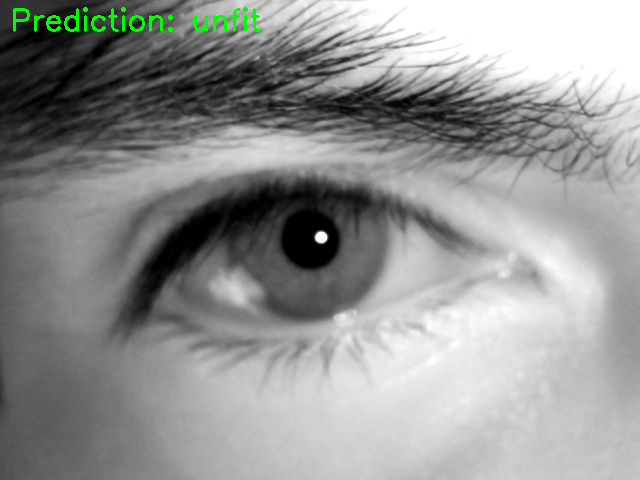

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


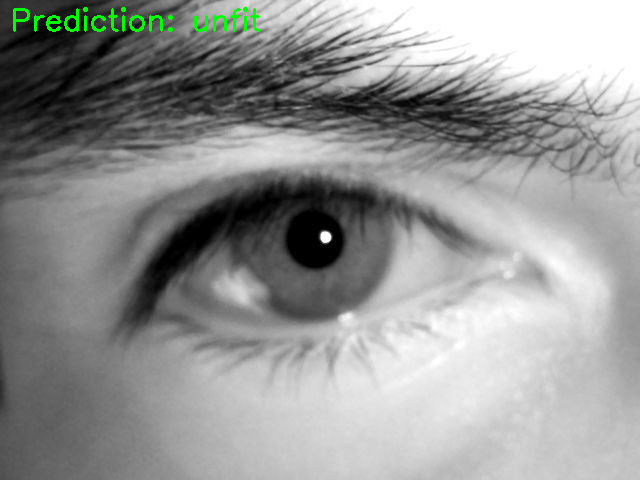

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step


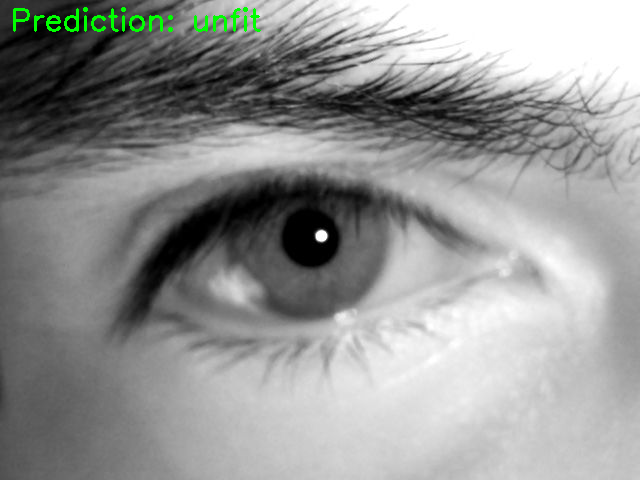

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


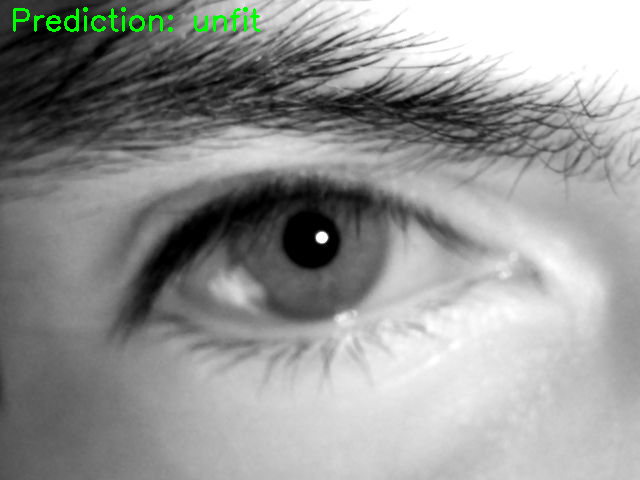

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


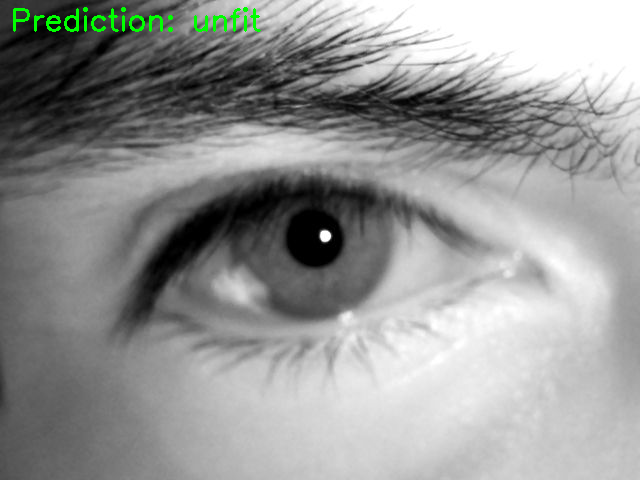

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


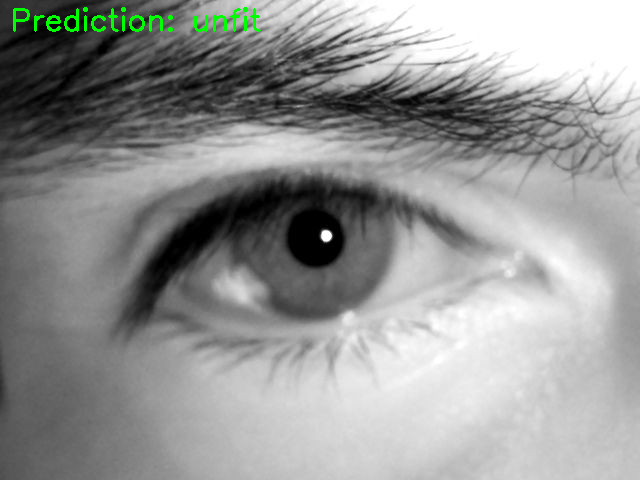

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


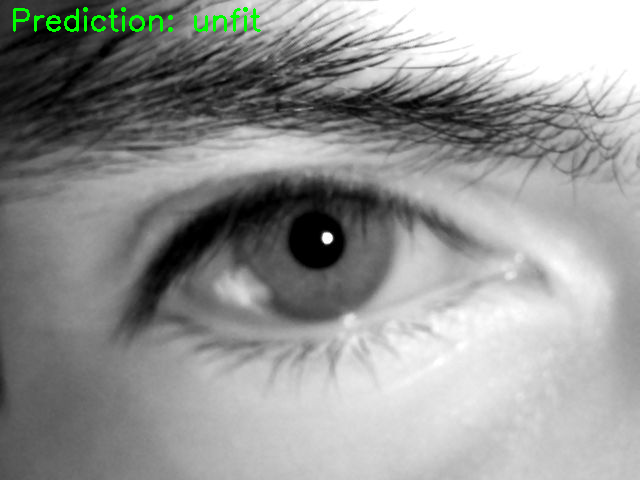

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


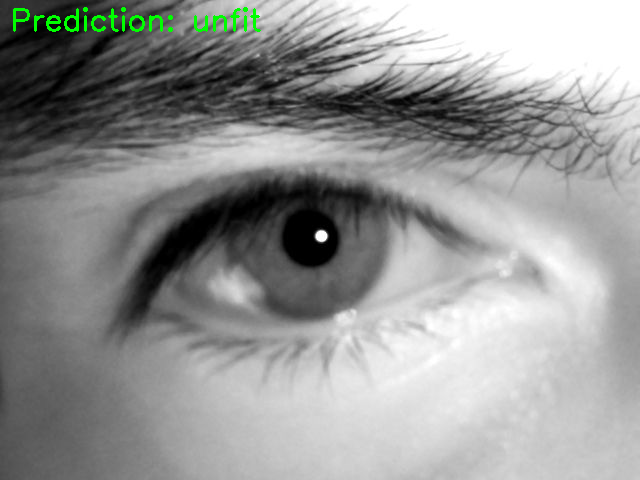

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


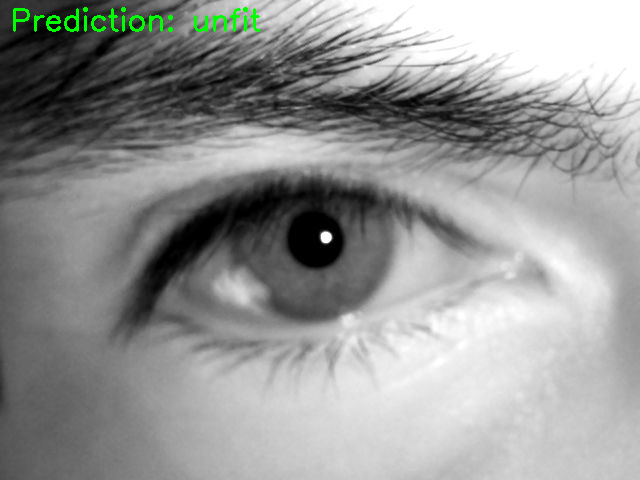

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


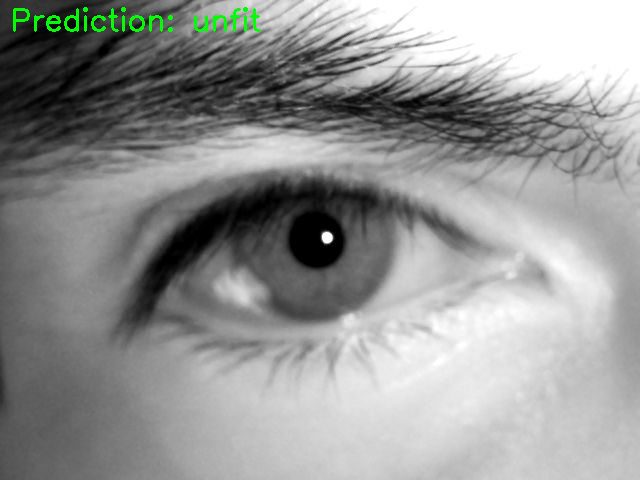

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step


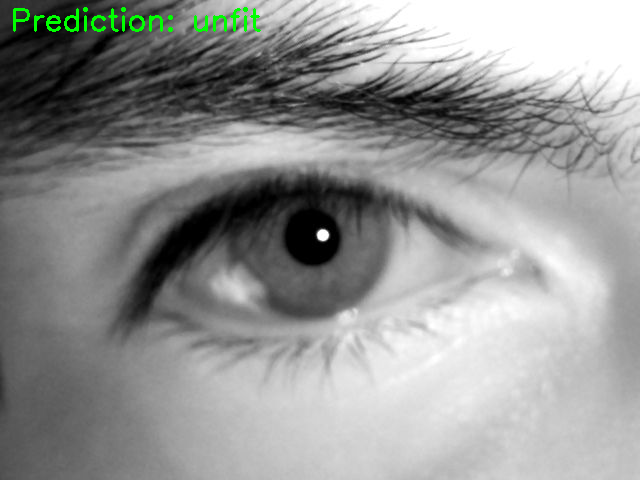

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


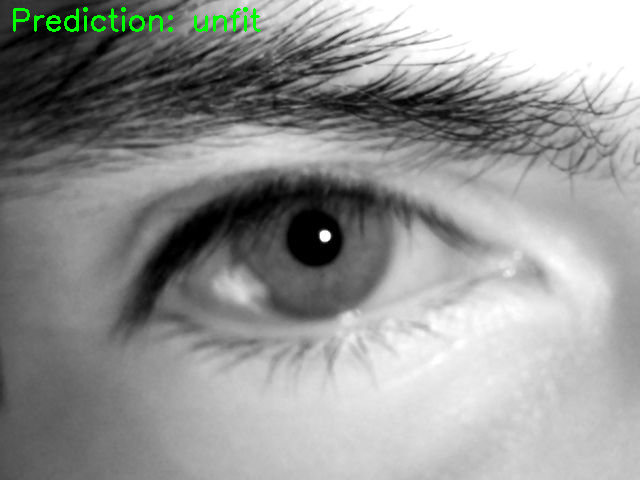

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step


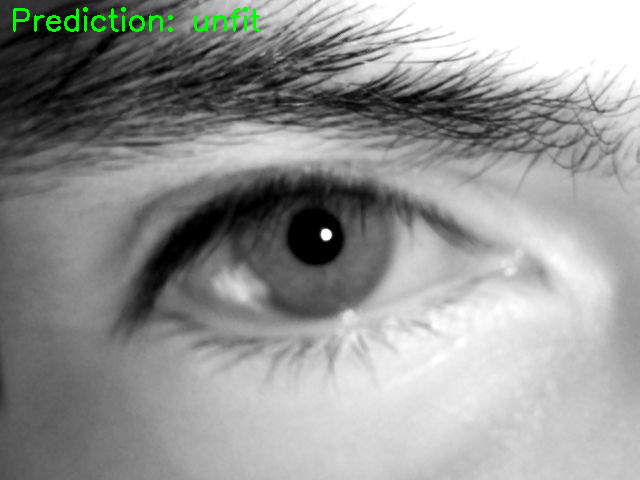

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


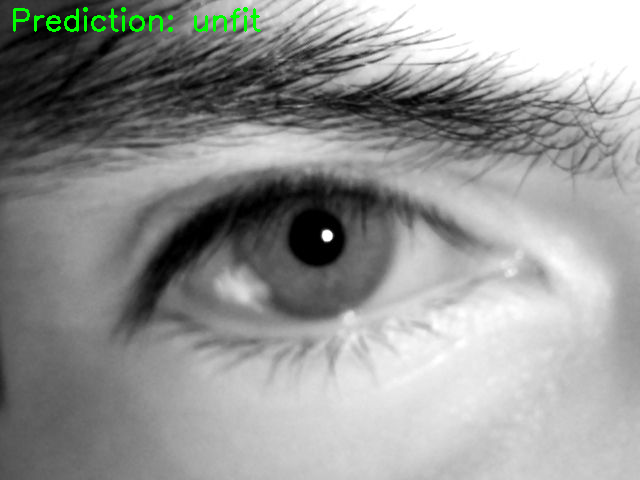

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


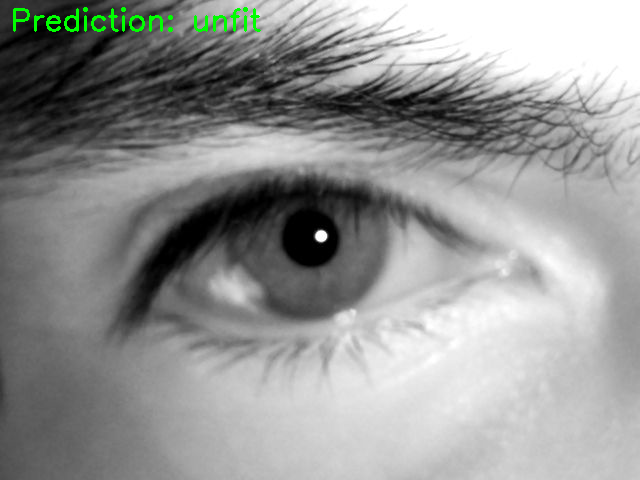

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


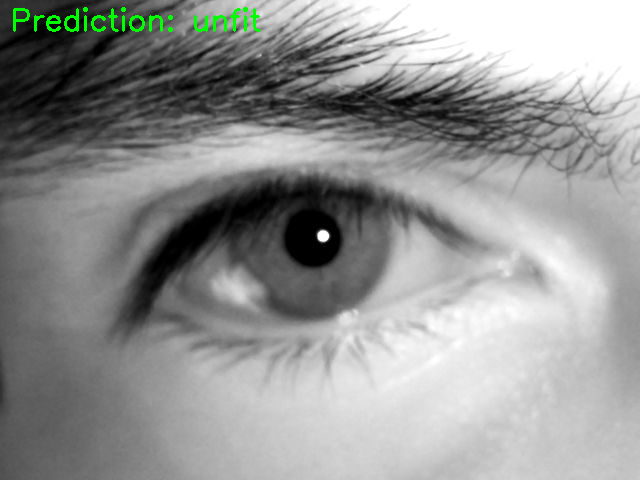

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


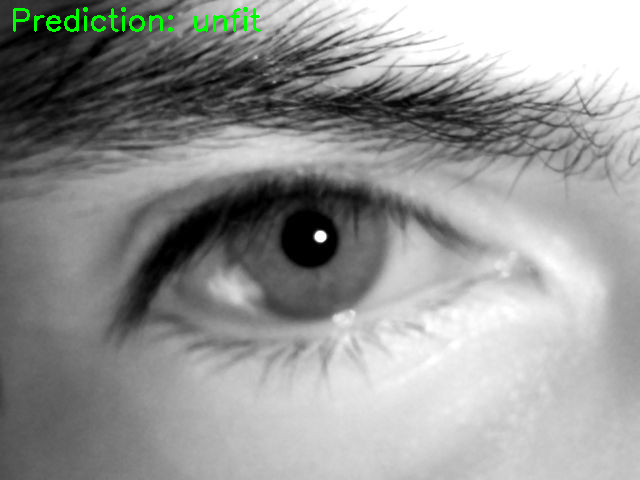

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


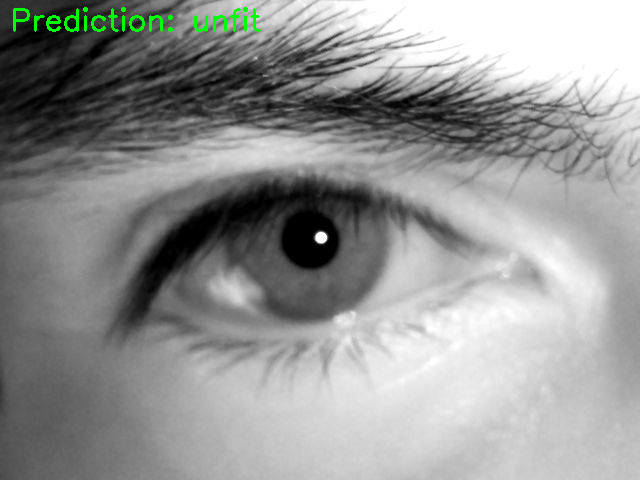

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


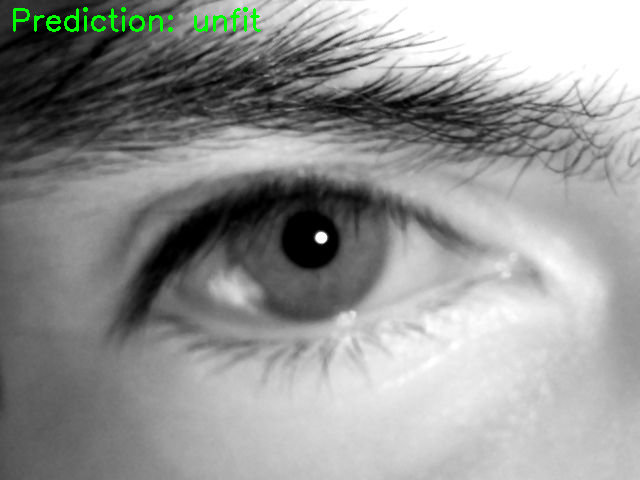

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


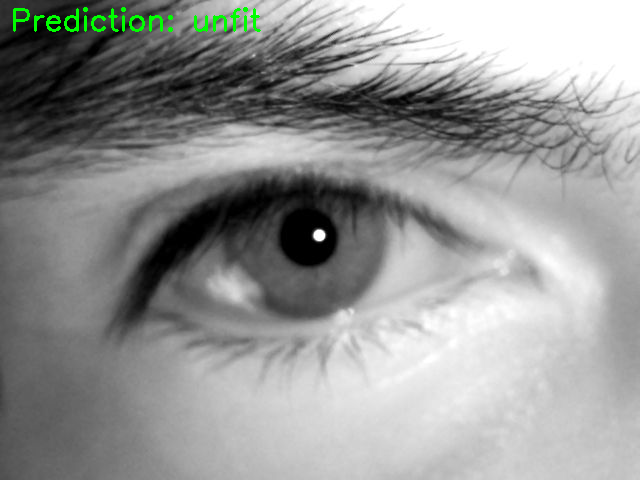

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


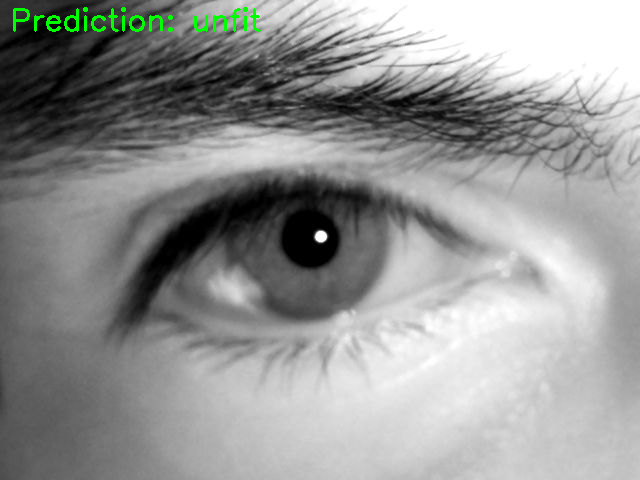

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


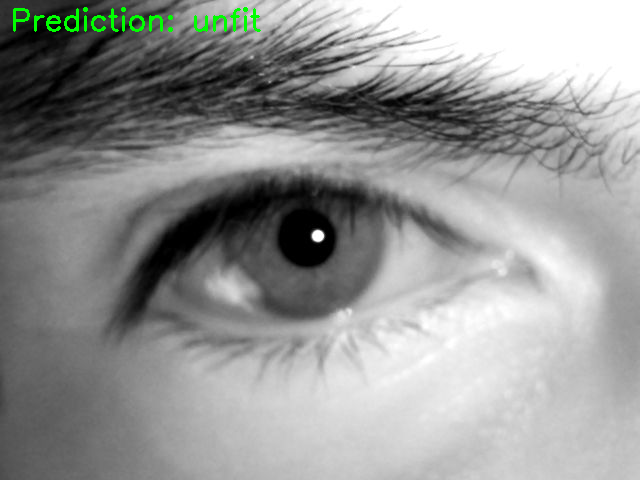

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow # Import the cv2_imshow function from google.colab.patches

def process_frame(frame):
    img = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    img = cv2.resize(img, (64, 64))
    img = img.reshape(-1, 64, 64, 1)  # Reshape for CNN
    img = img / 255.0  # Normalize
    return img

video_path = '/content/drive/MyDrive/MajorProject/input images/E_1_1_0_R.avi'
cap = cv2.VideoCapture(video_path)

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    processed_frame = process_frame(frame)

    # Make prediction on the processed frame
    prediction = cnn_model.predict(processed_frame)

    # Interpret the prediction
    if np.argmax(prediction) == 0:
        result = "fit"
    else:
        result = "unfit"

    # Display the result on the frame
    cv2.putText(frame, f"Prediction: {result}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    cv2_imshow(frame) # Use cv2_imshow instead of cv2.imshow

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

In [ ]:
from tensorflow.keras.preprocessing import image
import numpy as np
import cv2

def preprocess_image(img_path):
    # Check if the image was loaded correctly
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        print(f"Error: Could not load image at {img_path}")
        return None  # Return None if image loading fails

    img = cv2.resize(img, (64, 64))
    img = img.reshape(-1, 64, 64, 1)  # Reshape for CNN
    img = img / 255.0  # Normalize
    return img

# Load and preprocess the image
img_path = '/content/drive/MyDrive/MajorProject/input images/Some-iris-image-samples-with-high-medium-and-low-pigmentation-from-the-multi-modal.png'
processed_img = preprocess_image(img_path)

if processed_img is not None:
    # Make prediction
    prediction = cnn_model.predict(processed_img)

    # Interpret the prediction
    if np.argmax(prediction) == 0:
        result = "fit"
    else:
        result = "unfit"

    print(f'Prediction: {result}')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
Prediction: unfit
